In [1]:
import numpy as np
import pandas as pd

pd.options.display.max_columns = 100
pd.options.display.max_rows = 190

In [2]:
train = pd.read_csv('train_data.csv')
test = pd.read_csv('test_data.csv')

```
Overview
In this task, you have to build a model to predict the probability of a bid win inside an ad-exchange auction. Your main goal is to beat the provided baseline.
Description
What is an Ad-Exchange?
An ad-exchange is a digital marketplace that enables advertisers and publishers to buy and sell advertising space, often through real-time auctions. This platform facilitates the buying and selling process, making it more efficient and automated.
How It Works
Auction: When a user starts a mobile application, a bid request is sent from the publisher's ad server to the ad-exchange.
DSP (Demand-Side Platform): Advertisers use DSPs to decide which ad impressions to buy and how much to bid.
SSP (Supply-Side Platform): Publishers use SSPs to manage their advertising space inventory, ensuring they get the best price for each impression.
Winning Bid: The highest bid wins the auction, and the ad from that advertiser is displayed to the user.
Evaluation
The metric for this task is the F1 score. 
Baseline
F1 score: 0.503
ROC AUC: 0.667 (optional)
Data
You will be provided with two datasets:
train_data.csv: Use this dataset for training your model.
test_data.csv: Use this dataset for evaluation and comparison with the baseline.

======
Columns Description
target: The target variable indicating if the bid won (1) or lost (0).
flr: Floor price set by the publisher/exchange for the ad space.
sellerClearPrice: The price at which the seller is ready to sell the ad-space.
hour: The hour of the day the auction took place.
ssp: The Supply-Side Platform managing the auction.
dsp: The Demand-Side Platform participating in the auction.
auctionBidFloorSource: Source of the bid floor.
sdk: Software Development Kit used in the ad request.
sdkver: Version of the SDK.
bundle: The app bundle identifier.
os: Operating system of the user's device.
lang: Language setting of the user's device.
country: Country from which the bid request originated.
region: Region within the country.
request_context_device_w: Width of the user's device screen.
request_context_device_h: Height of the user's device screen.
bidderFlrPolicy: Bidder's floor price policy.
adt: Ad type requested.
dc: Data center handling the request.
contype: Connection type
request_context_device_type: Type of the user's device
ifa: Identifier for Advertisers (unique user identifier).
price: The final bid price submitted.

=====
Submission Requirements
Python Module: The training and inference solution should be formatted as a Python module. Ensure your code is modular, clean, and well-documented.
Jupyter Notebook: Results should be displayed in a Jupyter notebook. This notebook should include:
A clear explanation of your approach.
Key steps in the data processing, model training, and evaluation process.
Visualizations and metrics to support your results.
Comparison of your model's performance against the provided baseline.

=====

Auction - это не сущность, это процесс аукциона - выбора advertiser'а из всех, кто хочет купить место для рекламы. Аукцион проходит на стороне SSP, как написано в описании ssp
Advertiser - это предоставитель рекламы, тот, кто хочет купить место для своей рекламы у publisher'а
The advertiser and publisher are sellers - нет, publisher продаёт место, advertiser покупает. sellerClearPrice - к publisher'у
Does the following feature belong to the Auction? - аукцион не является сущностью (п.1)
Advertiser == User? (Winning Bid: The highest bid wins the auction, and the ad from that advertiser is displayed to the user.) - нет, advertiser, например, владелец приложения, который хочет продать конкретному юзеру свой продукт. ifa - рекламный идентификатор пользователя.
How to identify each actor from the system?:
User - ifa
publisher - никак, в этих данных уникального ключа для них, только фичи того, что им используется
auction - это не сущность (п.1), поэтому одна строка в данных - это результаты одного аукциона
advertiser - bundle. DSP - это посредник, который выступает от имени advertiser и участвует в аукционах для продажи рекламы
What does the empty value of ifa mean? - Юзер не дал разрешение на шеринг своего рекламного айди.
Imagine that our task is to estimate the probability of the user click (target ) on the impression of ad (ifa). - ifa не описывает рекламу, а юзера (выше)
Про ifa: https://www.techopedia.com/definition/29032/identifier-for-advertisers-ifa-ifda
```

In [3]:
train.shape, test.shape

((9640735, 23), (1500000, 23))

In [4]:
train.ssp.value_counts()

ssp
157    9640735
Name: count, dtype: int64

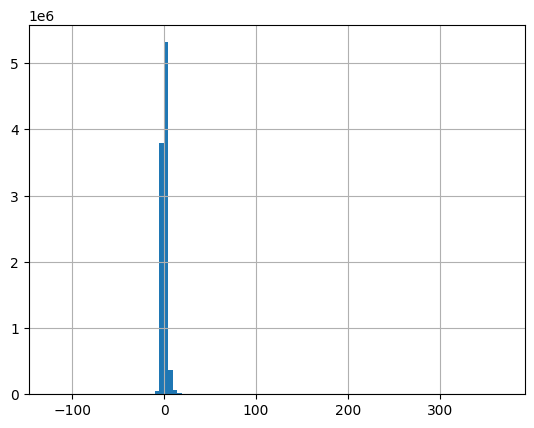

In [5]:
(train.sellerClearPrice - train.flr).hist(bins=100);

In [6]:
(train.sellerClearPrice - train.flr).describe()

count    9.640735e+06
mean     3.357437e-01
std      2.815356e+00
min     -1.227880e+02
25%     -5.924447e-01
50%     -1.620650e-01
75%      5.150580e-01
max      3.673500e+02
dtype: float64

In [7]:
train.loc[(train.sellerClearPrice - train.flr) > 0, :].describe()

,target,flr,sellerClearPrice,hour,ssp,dsp,request_context_device_w,request_context_device_h,contype,request_context_device_type,price
count,3.986886e+06,3.986886e+06,3.986886e+06,3.986886e+06,3986886.0,3.986886e+06,3.986886e+06,3.986886e+06,3.986886e+06,3.986886e+06,3.986886e+06
mean,1.422795e-01,2.127604e+00,4.044393e+00,1.158220e+01,157.0,7.583950e+01,7.542499e+02,1.484980e+03,2.523625e+00,4.230498e+00,5.341443e+00
std,3.493366e-01,2.947750e+00,5.315075e+00,7.559982e+00,0.0,2.873062e+01,2.913876e+02,6.079099e+02,1.242788e+00,4.251243e-01,7.142044e+00
min,0.000000e+00,9.999998e-03,1.060800e-02,0.000000e+00,157.0,2.300000e+01,3.200000e+02,3.200000e+02,0.000000e+00,1.000000e+00,1.116645e-02
25%,0.000000e+00,6.914997e-01,9.454703e-01,4.000000e+00,157.0,4.600000e+01,4.280000e+02,9.260000e+02,2.000000e+00,4.000000e+00,1.246967e+00
50%,0.000000e+00,7.500000e-01,1.944617e+00,1.300000e+01,157.0,8.000000e+01,8.000000e+02,1.340000e+03,2.000000e+00,4.000000e+00,2.598178e+00
75%,0.000000e+00,3.250000e+00,5.769885e+00,1.800000e+01,157.0,8.000000e+01,1.080000e+03,2.000000e+03,2.000000e+00,4.000000e+00,7.666884e+00
max,1.000000e+00,3.412781e+02,3.714500e+02,2.300000e+01,157.0,2.360000e+02,3.120000e+03,3.216000e+03,7.000000e+00,5.000000e+00,5.000000e+02


In [8]:
# We don't have negative revenue
train.loc[(train.sellerClearPrice - train.price) > 0, :].describe()

,target,flr,sellerClearPrice,hour,ssp,dsp,request_context_device_w,request_context_device_h,contype,request_context_device_type,price
count,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
mean,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
std,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
min,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
25%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
50%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
75%,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
max,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [10]:
train.head()

,target,flr,sellerClearPrice,hour,ssp,dsp,auctionBidFloorSource,sdk,sdkver,bundle,os,lang,country,region,request_context_device_w,request_context_device_h,bidderFlrPolicy,adt,dc,contype,request_context_device_type,ifa,price
0,0,1.651717,1.227061,0,157,80,rollouts,BidMachine,2.4.0.2,gAAAAABmcEFTEPcMMU786QLAISLs22JucTR9XWAoRq7NAM...,ios,en,US,nc,834.0,1194.0,ascending auction,interstitial,US,2.0,5.0,NaN,1.651717
1,0,5.388000,5.709376,3,157,80,rollouts,BidMachine,2.4.0.2,gAAAAABmcEFTEPcMMU786QLAISLs22JucTR9XWAoRq7NAM...,ios,en,US,sc,390.0,844.0,original,interstitial,US,2.0,4.0,NaN,7.685255
2,0,1.010250,1.728341,8,157,80,rollouts,BidMachine,2.4.0.2,gAAAAABmcEFTEPcMMU786QLAISLs22JucTR9XWAoRq7NAM...,ios,en,US,nv,393.0,852.0,original,interstitial,US,2.0,4.0,NaN,2.326478
3,0,0.741433,0.547470,12,157,80,rollouts,BidMachine,2.4.0.2,gAAAAABmcEFTEPcMMU786QLAISLs22JucTR9XWAoRq7NAM...,ios,en,MX,coa,414.0,896.0,ascending auction,interstitial,US,2.0,4.0,NaN,0.756278
4,0,1.010250,1.721669,0,157,80,rollouts,BidMachine,2.4.0.2,gAAAAABmcEFTEPcMMU786QLAISLs22JucTR9XWAoRq7NAM...,ios,en,US,il,414.0,896.0,original,interstitial,US,2.0,4.0,E30F6295-BCBC-4BD2-A1C4-2198F1EA38F2,2.317498


In [11]:
from ydata_profiling import ProfileReport
profile = ProfileReport(train, title="Train Data Profiling Report")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

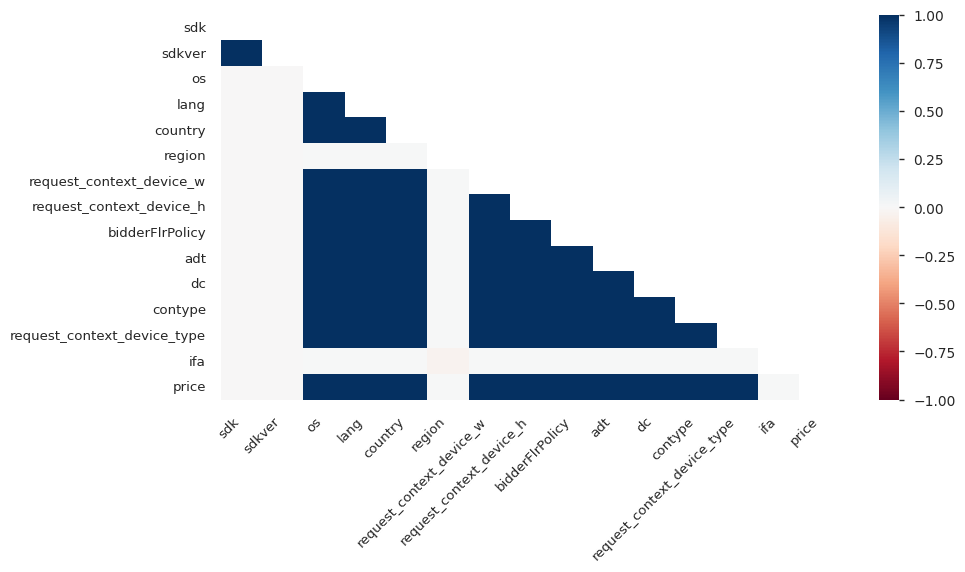

In [12]:
profile

In [13]:
from ydata_profiling import ProfileReport
profile_test = ProfileReport(test, title="Test Data Profiling Report")

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

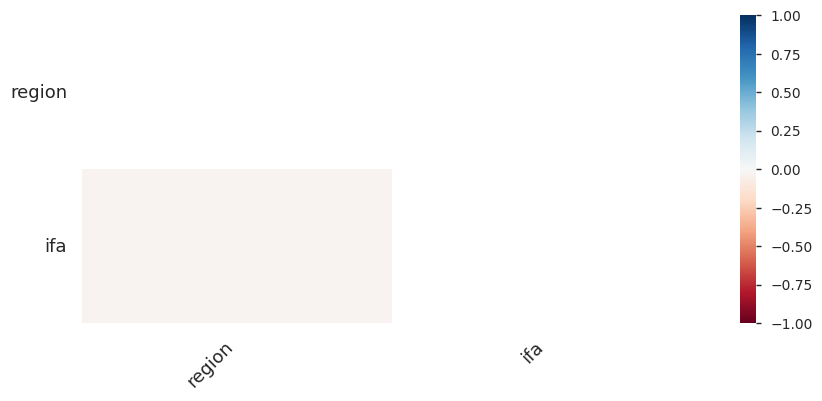

In [14]:
profile_test

In [16]:
train.loc[train.ifa == '8ecb985e-c58e-416b-89d8-ebf0c9f8ca47', :]

,target,flr,sellerClearPrice,hour,ssp,dsp,auctionBidFloorSource,sdk,sdkver,bundle,os,lang,country,region,request_context_device_w,request_context_device_h,bidderFlrPolicy,adt,dc,contype,request_context_device_type,ifa,price
3213983,1,0.6915,1.570549,19,157,76,rollouts,BidMachine,2.5.0,gAAAAABmcEFTqdQlw0hfUdTmDmhGvCDApGMhNBnU3nIMJm...,android,es,CO,dc,1080.0,2340.0,ascending auction,interstitial,US,6.0,4.0,8ecb985e-c58e-416b-89d8-ebf0c9f8ca47,2.169566
3235527,1,0.6915,1.139935,21,157,76,ml,BidMachine,2.5.0,gAAAAABmcEFTqdQlw0hfUdTmDmhGvCDApGMhNBnU3nIMJm...,android,es,CO,dc,1080.0,2340.0,ascending auction,interstitial,US,2.0,4.0,8ecb985e-c58e-416b-89d8-ebf0c9f8ca47,1.574713
3787852,0,0.6915,0.758606,18,157,76,ml,BidMachine,2.5.0,gAAAAABmcEFTqdQlw0hfUdTmDmhGvCDApGMhNBnU3nIMJm...,android,es,CO,dc,1080.0,2340.0,ascending auction,interstitial,US,2.0,4.0,8ecb985e-c58e-416b-89d8-ebf0c9f8ca47,1.047943
4976921,1,0.6915,1.425631,14,157,76,rollouts,BidMachine,2.5.0,gAAAAABmcEFTqdQlw0hfUdTmDmhGvCDApGMhNBnU3nIMJm...,android,es,CO,dc,1080.0,2340.0,ascending auction,interstitial,US,2.0,4.0,8ecb985e-c58e-416b-89d8-ebf0c9f8ca47,1.969375
9438082,1,0.6915,0.918085,1,157,76,ml,BidMachine,2.5.0,gAAAAABmcEFTqdQlw0hfUdTmDmhGvCDApGMhNBnU3nIMJm...,android,es,CO,dc,1080.0,2340.0,ascending auction,interstitial,US,2.0,4.0,8ecb985e-c58e-416b-89d8-ebf0c9f8ca47,1.268248


In [17]:
test.loc[test.ifa == '8ecb985e-c58e-416b-89d8-ebf0c9f8ca47', :]

,target,flr,sellerClearPrice,hour,ssp,dsp,auctionBidFloorSource,sdk,sdkver,bundle,os,lang,country,region,request_context_device_w,request_context_device_h,bidderFlrPolicy,adt,dc,contype,request_context_device_type,ifa,price
335388,0,0.6915,0.518593,20,157,76,ml,BidMachine,2.5.0,gAAAAABmcEFTqdQlw0hfUdTmDmhGvCDApGMhNBnU3nIMJm...,android,es,CO,dc,1080,2340,ascending auction,interstitial,US,2,4,8ecb985e-c58e-416b-89d8-ebf0c9f8ca47,0.716388
444157,0,0.6915,1.368250,10,157,76,ml,BidMachine,2.5.0,gAAAAABmcEFTqdQlw0hfUdTmDmhGvCDApGMhNBnU3nIMJm...,android,es,CO,dc,1080,2340,ascending auction,interstitial,US,2,4,8ecb985e-c58e-416b-89d8-ebf0c9f8ca47,1.890108
489967,1,0.6915,5.401562,12,157,76,ml,BidMachine,2.5.0,gAAAAABmcEFTqdQlw0hfUdTmDmhGvCDApGMhNBnU3nIMJm...,android,es,CO,dc,1080,2340,ascending auction,interstitial,US,2,4,8ecb985e-c58e-416b-89d8-ebf0c9f8ca47,7.461750
1197265,0,0.6915,0.983254,10,157,76,ml,BidMachine,2.5.0,gAAAAABmcEFTqdQlw0hfUdTmDmhGvCDApGMhNBnU3nIMJm...,android,es,CO,dc,1080,2340,ascending auction,interstitial,US,2,4,8ecb985e-c58e-416b-89d8-ebf0c9f8ca47,1.358273


In [15]:
list(set(test.ifa ) & set(train.ifa))[:10]

['8ecb985e-c58e-416b-89d8-ebf0c9f8ca47',
 '1af3315e-286b-4bda-ac78-ef1508242a51',
 'ee3c6c20-465d-42d4-b343-3a6e7e8e551f',
 '9af4aa12-396b-4104-88c3-40cfe723cbec',
 'c7f53d46-f643-42a5-991f-85607cf87d61',
 '29CC56D6-1578-48CF-A195-B102CE95A623',
 'e7cebc9c-6000-4679-ac53-176ece1c412d',
 '4A31E35F-09DA-4B46-BDDA-DD8C5F447444',
 'd81f51ef-1457-4138-89df-0826540b7233',
 'bd4fc0ca-8de7-4b05-837e-7c139abcc0dc']

# Summary
- There are some features with one and only value ('ssp', 'sdk', 'adt', 'dc')
- We have multiple impressions per user. It could be a reason of leakage, because the new prediction of target could be correlated with old predictions. I use the `ifa` column as a sampling feature.
- Also, we could try to use `dsp` column as a sampling unit. We have a comment from a task:" Advertisers use DSPs to decide which ad impressions to buy and how much to bid". If Maybe our task to predict the probability of target and choose the best dsp for a post. In this case we are not able to use `dsp` as a feature.
- There are shared users between Train and Test data